In [1]:
import matplotlib.pylab as pylab
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error as mae
from sklearn.metrics import r2_score, mean_squared_error
import pandas as pd
import numpy as np
from rdkit import Chem
from rdkit.Chem import rdMolDescriptors
from tqdm import tqdm
tqdm.pandas()

def rmse(y, y_pred):
    return np.sqrt(mean_squared_error(y, y_pred))

def get_nheavy(smiles):
    mol = Chem.MolFromSmiles(smiles)
    return rdMolDescriptors.CalcNumHeavyAtoms(mol)


def plotxy(ax, X, Y, size=1.0, color=None, square=False, xlabel=None,
           ylabel=None, type='scatter', alpha=1.0, label=None, linestyle=None,
           fontsize=20):
    lx = X.min()
    ux = X.max()
    ly = Y.min()
    uy = Y.max()
    if square:
        lx = ly = min(lx, ly)
        ux = uy = max(ux, uy)
    dx = (ux - lx)
    dy = (uy - ly)
    if type == 'scatter':
        ax.scatter(X, Y, s=size, c=color, alpha=alpha, label=label, edgecolor='k')
    elif type == 'line':
        ax.plot(X, Y, c=color, linewidth=size, linestyle=linestyle, label=label,
                alpha=alpha)
    if xlabel is not None:
        ax.set_xlabel(xlabel)
    if ylabel is not None:
        ax.set_ylabel(ylabel)
    ax.tick_params()
    ax.set_xlim(lx - dx * 0.01, ux + dx * 0.01)
    ax.set_ylim(ly - dy * 0.01, uy + dy * 0.01)
    return lx - dx * 0.01, ux + dx * 0.01, dx * 1.02, ly - dy * 0.01, uy + dy * 0.01, dy * 1.02



In [2]:
df = pd.read_csv('alkane.csv')
df['nheavy'] = df.smiles.progress_apply(get_nheavy)
nheavy = list(range(4, 20))
number_alkane = [len(df[df['nheavy'] == n]) for n in nheavy]

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 251728/251728 [00:13<00:00, 18308.26it/s]


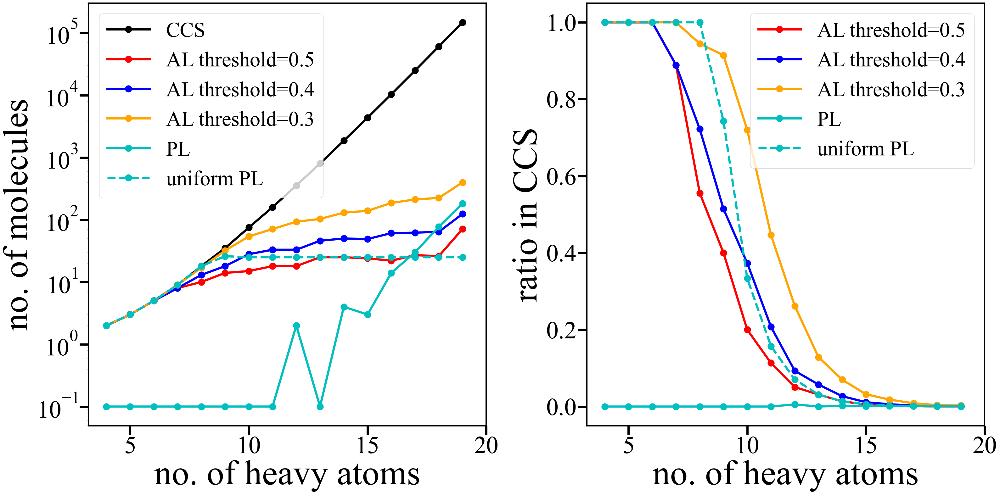

In [9]:
fs = 16
params = {'legend.fontsize': '%s' % (3 * fs),
          'figure.figsize': (fs * 2, fs * 1),  # 8*6
          'axes.labelsize': '%s' % (5 * fs),
          'axes.titlesize': '%s' % (5 * fs),
          'xtick.labelsize': '%s' % (3.5 * fs),
          'ytick.labelsize': '%s' % (3.5 * fs),
          'font.family': 'serif',
          'font.serif': 'Times New Roman',
          'axes.linewidth': 3,
          }
pylab.rcParams.update(params)
fig = plt.figure()
fig.tight_layout()

dxs = [0.09, 0.1, 0.02]  # left to right
dx = (1 - sum(dxs)) / (len(dxs) - 1)
dys = [0.14, 0.02]  # down to top
dy = (1 - sum(dys)) / (len(dys) - 1)

nx = 1
ny = 1
ax = fig.add_axes(
    [sum(dxs[:nx]) + (nx - 1) * dx, sum(dys[:ny]) + (ny - 1) * dy, dx, dy])
ax.tick_params(width=5, length=20)

ax.plot(nheavy, number_alkane, '-o', linewidth=5, markersize=15, label='CCS', color='black')

df = pd.DataFrame({'smiles': pd.read_csv(f'data_0.5_0/density.csv').smiles.unique()})
df['nheavy'] = df.smiles.apply(get_nheavy)
nheavy = list(range(4, 20))
number = [len(df[df['nheavy'] == n]) for n in nheavy]
ax.plot(nheavy, number, '-o', linewidth=5, markersize=15, label='AL threshold=0.5', color='red')

df = pd.DataFrame({'smiles': pd.read_csv('data_0.4_0/density.csv').smiles.unique()})
df['nheavy'] = df.smiles.apply(get_nheavy)
nheavy = list(range(4, 20))
number = [len(df[df['nheavy'] == n]) for n in nheavy]
ax.plot(nheavy, number, '-o', linewidth=5, markersize=15, label='AL threshold=0.4', color='blue')

df = pd.DataFrame({'smiles': pd.read_csv('data_0.3_0/density.csv').smiles.unique()})
df['nheavy'] = df.smiles.apply(get_nheavy)
nheavy = list(range(4, 20))
number = [len(df[df['nheavy'] == n]) for n in nheavy]
ax.plot(nheavy, number, '-o', linewidth=5, markersize=15, label='AL threshold=0.3', color='orange')

df = pd.DataFrame({'smiles': pd.read_csv('data_0.5_random0/density.csv').smiles.unique()})
df['nheavy'] = df.smiles.apply(get_nheavy)
nheavy = list(range(4, 20))
number = [len(df[df['nheavy'] == n]) for n in nheavy]
number = [n if n != 0 else 0.1 for n in number]
ax.plot(nheavy, number, '-o', linewidth=5, markersize=15, label='PL', color='c')

df = pd.DataFrame({'smiles': pd.read_csv('data_0.5_nheavy0/density.csv').smiles.unique()})
df['nheavy'] = df.smiles.apply(get_nheavy)
nheavy = list(range(4, 20))
number = [len(df[df['nheavy'] == n]) for n in nheavy]
ax.plot(nheavy, number, '--o', linewidth=5, markersize=15, label='uniform PL', color='c')

ax.legend()
ax.set_xticks([5, 10, 15, 20])
ax.set_yscale('log')
ax.set_ylabel('no. of molecules')
ax.set_xlabel('no. of heavy atoms')


nx = 2
ny = 1
ax = fig.add_axes(
    [sum(dxs[:nx]) + (nx - 1) * dx, sum(dys[:ny]) + (ny - 1) * dy, dx, dy])
ax.tick_params(width=5, length=20)

df = pd.DataFrame({'smiles': pd.read_csv(f'data_0.5_0/density.csv').smiles.unique()})
df['nheavy'] = df.smiles.apply(get_nheavy)
nheavy = list(range(4, 20))
number = [len(df[df['nheavy'] == n]) for n in nheavy]
ax.plot(nheavy, np.array(number) / np.array(number_alkane), '-o', linewidth=5, markersize=15, label='AL threshold=0.5', color='red')

df = pd.DataFrame({'smiles': pd.read_csv('data_0.4_0/density.csv').smiles.unique()})
df['nheavy'] = df.smiles.apply(get_nheavy)
nheavy = list(range(4, 20))
number = [len(df[df['nheavy'] == n]) for n in nheavy]
ax.plot(nheavy, np.array(number) / np.array(number_alkane), '-o', linewidth=5, markersize=15, label='AL threshold=0.4', color='blue')

df = pd.DataFrame({'smiles': pd.read_csv('data_0.3_0/density.csv').smiles.unique()})
df['nheavy'] = df.smiles.apply(get_nheavy)
nheavy = list(range(4, 20))
number = [len(df[df['nheavy'] == n]) for n in nheavy]
ax.plot(nheavy, np.array(number) / np.array(number_alkane), '-o', linewidth=5, markersize=15, label='AL threshold=0.3', color='orange')

df = pd.DataFrame({'smiles': pd.read_csv('data_0.5_random0/density.csv').smiles.unique()})
df['nheavy'] = df.smiles.apply(get_nheavy)
nheavy = list(range(4, 20))
number = [len(df[df['nheavy'] == n]) for n in nheavy]
ax.plot(nheavy, np.array(number) / np.array(number_alkane), '-o', linewidth=5, markersize=15, label='PL', color='c')

df = pd.DataFrame({'smiles': pd.read_csv('data_0.5_nheavy0/density.csv').smiles.unique()})
df['nheavy'] = df.smiles.apply(get_nheavy)
nheavy = list(range(4, 20))
number = [len(df[df['nheavy'] == n]) for n in nheavy]
ax.plot(nheavy, np.array(number) / np.array(number_alkane), '--o', linewidth=5, markersize=15, label='uniform PL', color='c')

ax.legend()
ax.set_xticks([5, 10, 15, 20])
ax.set_ylabel('ratio in CCS')
ax.set_xlabel('no. of heavy atoms')

plt.savefig('figure2.png')

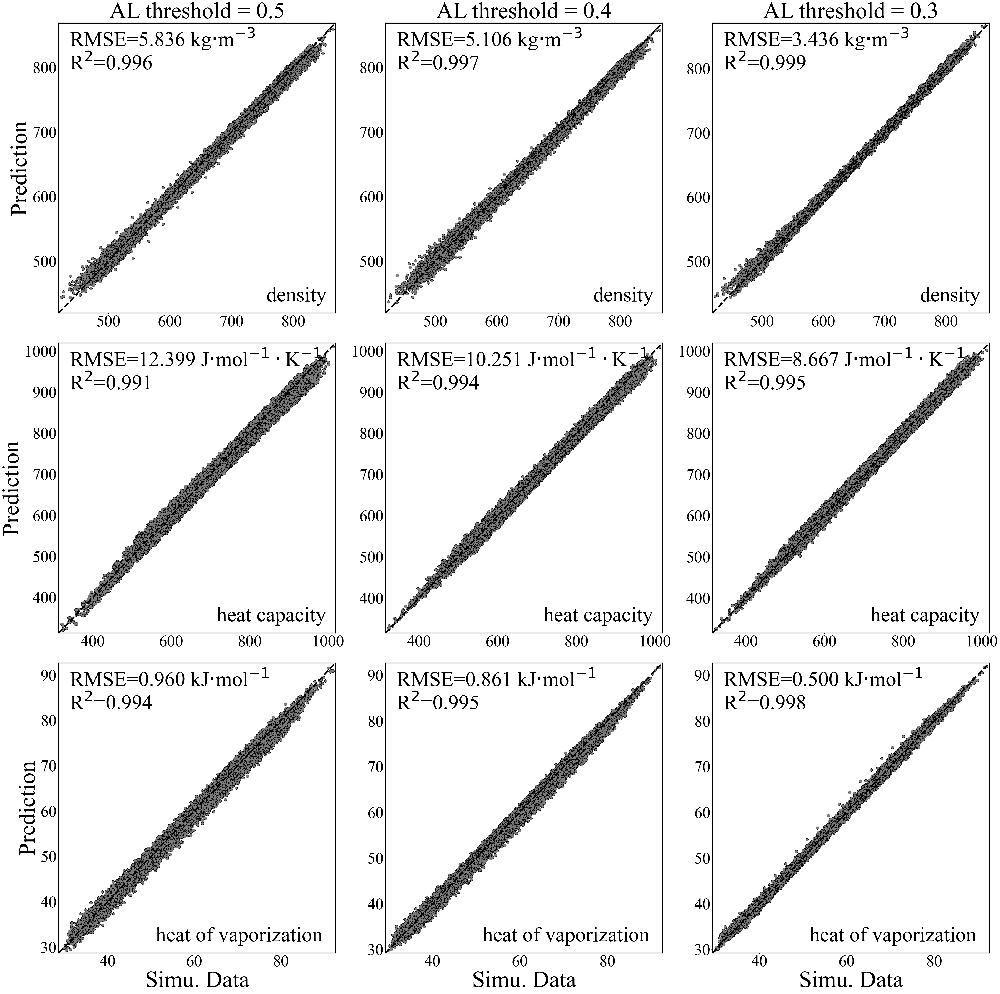

In [5]:
fs = 16
params = {'legend.fontsize': '%s' % (4 * fs),
          'figure.figsize': (fs * 3, fs * 3),  # 8*6
          'axes.labelsize': '%s' % (5 * fs),
          'axes.titlesize': '%s' % (5 * fs),
          'xtick.labelsize': '%s' % (3.5 * fs),
          'ytick.labelsize': '%s' % (3.5 * fs),
          'font.family': 'serif',
          'font.serif': 'Times New Roman',
          'axes.linewidth': 3
          }
pylab.rcParams.update(params)
fig = plt.figure()
fig.tight_layout()

dxs = [0.06, 0.05, 0.05, 0.01]  # left to right
dx = (1 - sum(dxs)) / (len(dxs) - 1)
dys = [0.04, 0.03, 0.03, 0.03]  # down to top
dy = (1 - sum(dys)) / (len(dys) - 1)

for i, n in enumerate([0.5, 0.4, 0.3]):
    for j, prop in enumerate(['hvap', 'cp', 'density']):
        prop_name = ['heat of vaporization', 'heat capacity', 'density'][j]
        unit = [r'kJ$\cdot$mol$^{-1}$', r'J$\cdot$mol$^{-1} \cdot$K$^{-1}$', r'kg$\cdot$m$^{-3}$'][j]
        nx = i + 1
        ny = j + 1
        ax = fig.add_axes(
            [sum(dxs[:nx]) + (nx - 1) * dx, sum(dys[:ny]) + (ny - 1) * dy, dx, dy])
        df = pd.read_csv(f'data_test3000/{prop}-{n}_0-pred.csv')
        df_true = pd.read_csv(f'data_test3000/{prop}.csv')
        if j == 0:
            df['nheavy'] = df.smiles.apply(get_nheavy)
            df['hvap'] -= df['nheavy'] * df['T'] * 8.314 / 1000 / 15
            df_true['nheavy'] = df_true.smiles.apply(get_nheavy)
            df_true['hvap'] -= df_true['nheavy'] * df_true['T'] * 8.314 / 1000 / 15
        l, u, d, _, _, _ = plotxy(ax, df_true[prop], df[prop], square=True, size=100, color='gray')
        ax.plot([l, u], [l, u], c='k', linestyle='--', linewidth=fs/3)
        ax.text(l + 0.04 * d, u - 0.08 * d,
                r'RMSE=%.3f %s' % (rmse(df_true[prop], df[prop]), unit),
                fontsize=fs*4.5, color='k')
        ax.text(l + 0.04 * d, u - 0.16 * d,
                r'R$^2$=%.3f' % (r2_score(df_true[prop], df[prop])),
                fontsize=fs*4.5, color='k')
        if j == 2:
            ax.text(l + 0.75 * d, l + 0.04 * d, prop_name, fontsize=fs * 4.5)
        elif j == 1:
            ax.text(l + 0.57 * d, l + 0.04 * d, prop_name, fontsize=fs * 4.5)
        else:
            ax.text(l + 0.35 * d, l + 0.04 * d, prop_name, fontsize=fs * 4.5)
        # ax.text(l + 0.04 * d, u - 0.24 * d, r'0.4 T$\rm_c$< T <0.9 T$\rm_c$', fontsize=fs * 3.5, color='k')
        # ax.set_title('AL threshold = 0.5')
        # ax.set_ylabel('Prediction')
        if j == 0:
            ax.set_xlabel('Simu. Data')
        if j == 2:
            ax.set_title(f'AL threshold = {n}')
        if i == 0:
            ax.set_ylabel('Prediction')
plt.savefig('figure3.png')

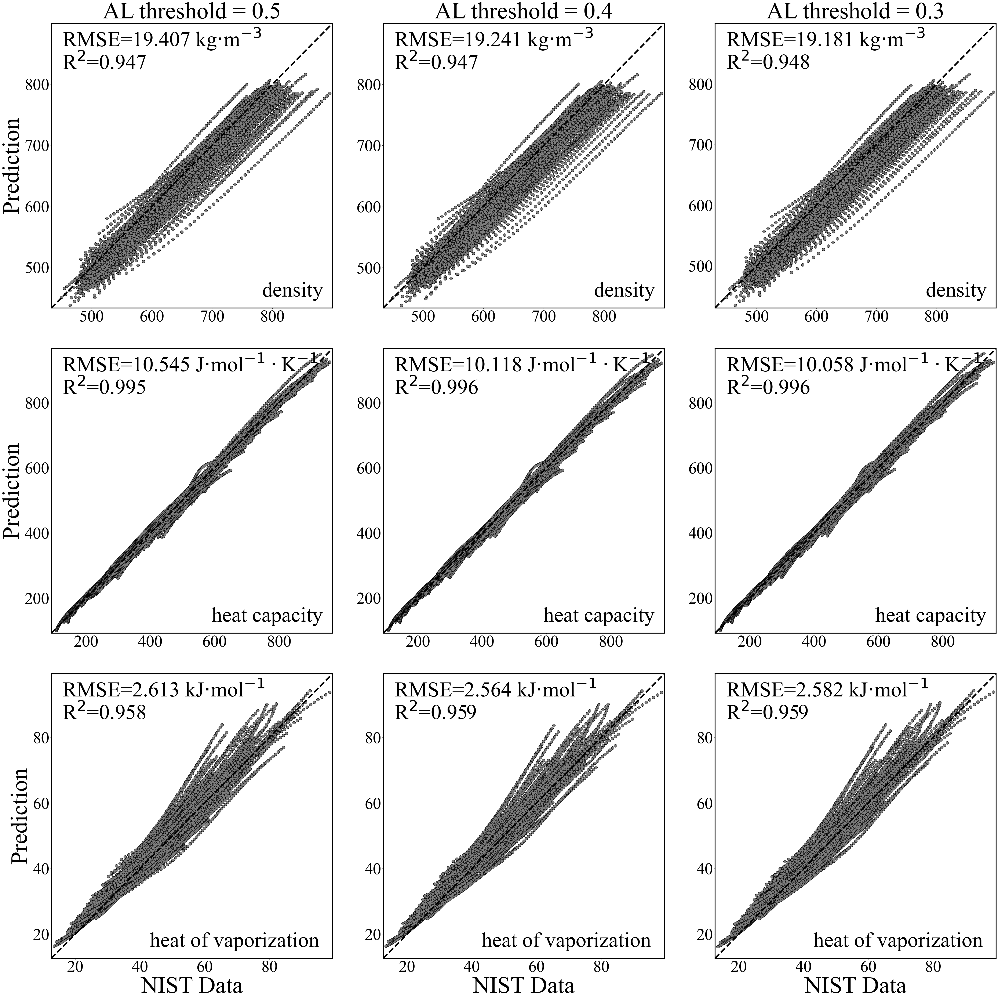

In [6]:
fs = 16
params = {'legend.fontsize': '%s' % (4 * fs),
          'figure.figsize': (fs * 3, fs * 3),  # 8*6
          'axes.labelsize': '%s' % (5 * fs),
          'axes.titlesize': '%s' % (5 * fs),
          'xtick.labelsize': '%s' % (3.5 * fs),
          'ytick.labelsize': '%s' % (3.5 * fs),
          'font.family': 'serif',
          'font.serif': 'Times New Roman',
          'axes.linewidth': 3
          }
pylab.rcParams.update(params)
fig = plt.figure()
fig.tight_layout()

dxs = [0.06, 0.05, 0.05, 0.01]  # left to right
dx = (1 - sum(dxs)) / (len(dxs) - 1)
dys = [0.04, 0.04, 0.04, 0.04]  # down to top
dy = (1 - sum(dys)) / (len(dys) - 1)

for i, n in enumerate([0.5, 0.4, 0.3]):
    for j, prop in enumerate(['hvap', 'cp', 'density']):
        prop_name = ['heat of vaporization', 'heat capacity', 'density'][j]
        unit = [r'kJ$\cdot$mol$^{-1}$', r'J$\cdot$mol$^{-1} \cdot$K$^{-1}$', r'kg$\cdot$m$^{-3}$'][j]
        nx = i + 1
        ny = j + 1
        ax = fig.add_axes(
            [sum(dxs[:nx]) + (nx - 1) * dx, sum(dys[:ny]) + (ny - 1) * dy, dx, dy])
        df = pd.read_csv(f'data_exp/{prop}-{n}_0-pred.csv')
        df = df[(df.nheavy >= 4) & (df.nheavy <= 19) & (df.red_T > 0.4) & (df.red_T < 0.9)]
        if j == 0:
            df = df[df['T'] > df['tt'] + 2]
            df['hvap'] -= df['nheavy'] * df['T'] * 8.314 / 1000 / 15
        l, u, d, _, _, _ = plotxy(ax, df[prop + '-lg'], df[prop], square=True, size=100, color='gray')
        ax.plot([l, u], [l, u], c='k', linestyle='--', linewidth=fs/3)
        ax.text(l + 0.04 * d, u - 0.08 * d,
                r'RMSE=%.3f %s' % (rmse(df[prop + '-lg'], df[prop]), unit),
                fontsize=fs*4.5, color='k')
        ax.text(l + 0.04 * d, u - 0.16 * d,
                r'R$^2$=%.3f' % (r2_score(df[prop + '-lg'], df[prop])),
                fontsize=fs*4.5, color='k')
        if j == 2:
            ax.text(l + 0.75 * d, l + 0.04 * d, prop_name, fontsize=fs * 4.5)
        elif j == 1:
            ax.text(l + 0.57 * d, l + 0.04 * d, prop_name, fontsize=fs * 4.5)
        else:
            ax.text(l + 0.35 * d, l + 0.04 * d, prop_name, fontsize=fs * 4.5)
        # ax.text(l + 0.04 * d, u - 0.24 * d, r'0.4 T$\rm_c$< T <0.9 T$\rm_c$', fontsize=fs * 3.5, color='k')
        # ax.set_title('AL threshold = 0.5')
        # ax.set_ylabel('Prediction')
        if j == 0:
            ax.set_xlabel('NIST Data')
        if j == 2:
            ax.set_title(f'AL threshold = {n}')
        if i == 0:
            ax.set_ylabel('Prediction')

plt.savefig('figure4.png')

<Figure size 4800x4800 with 0 Axes>

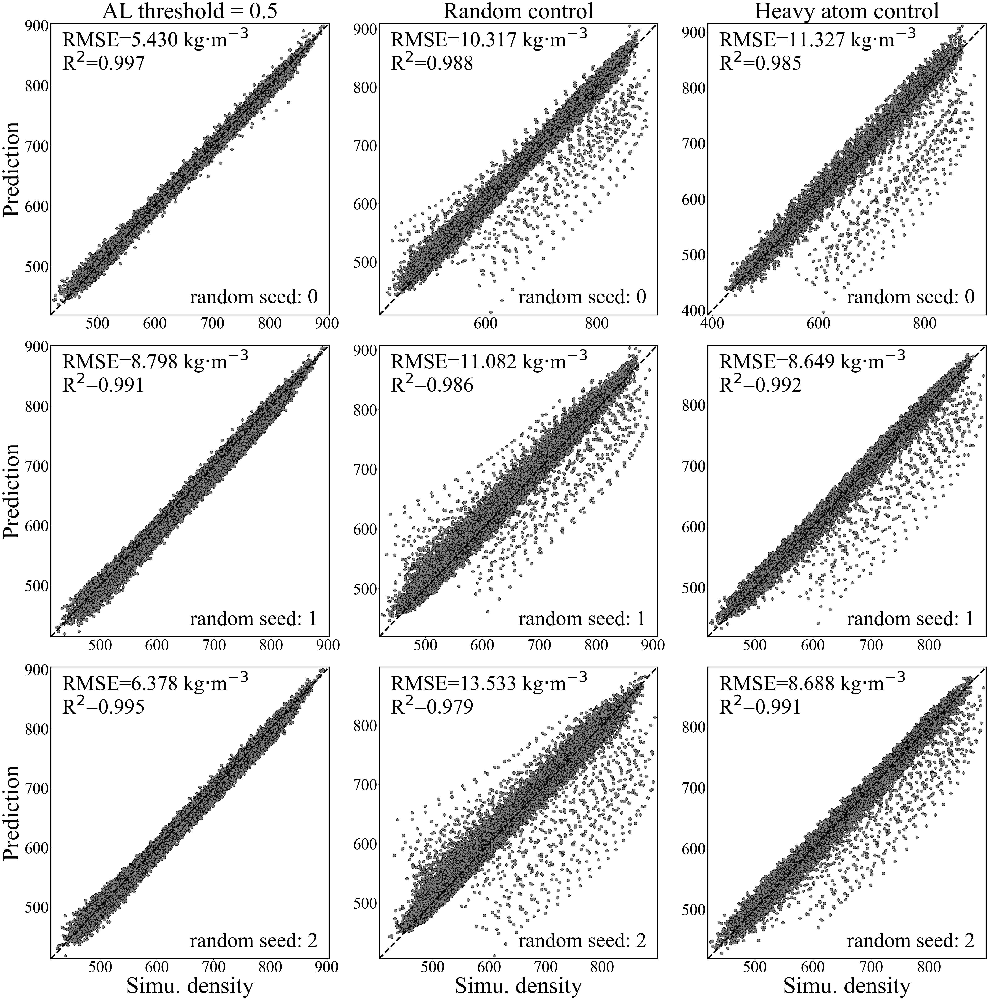

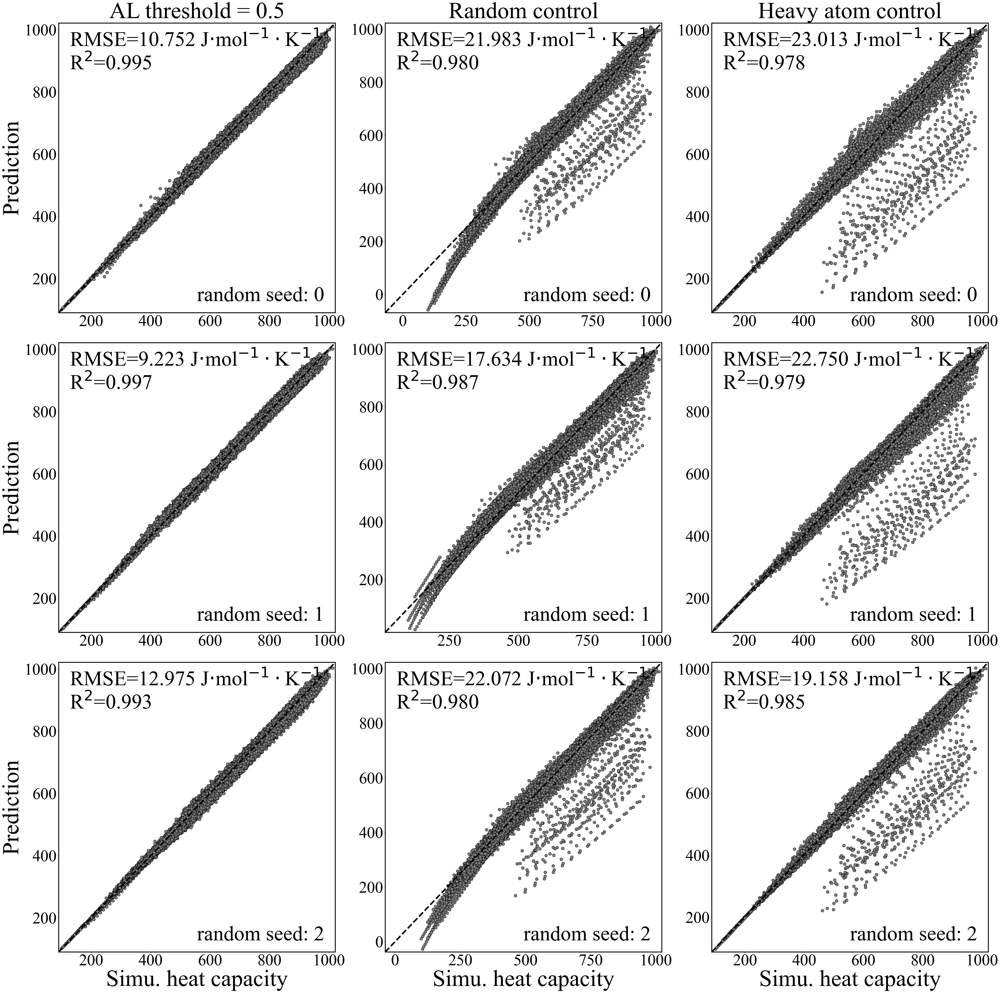

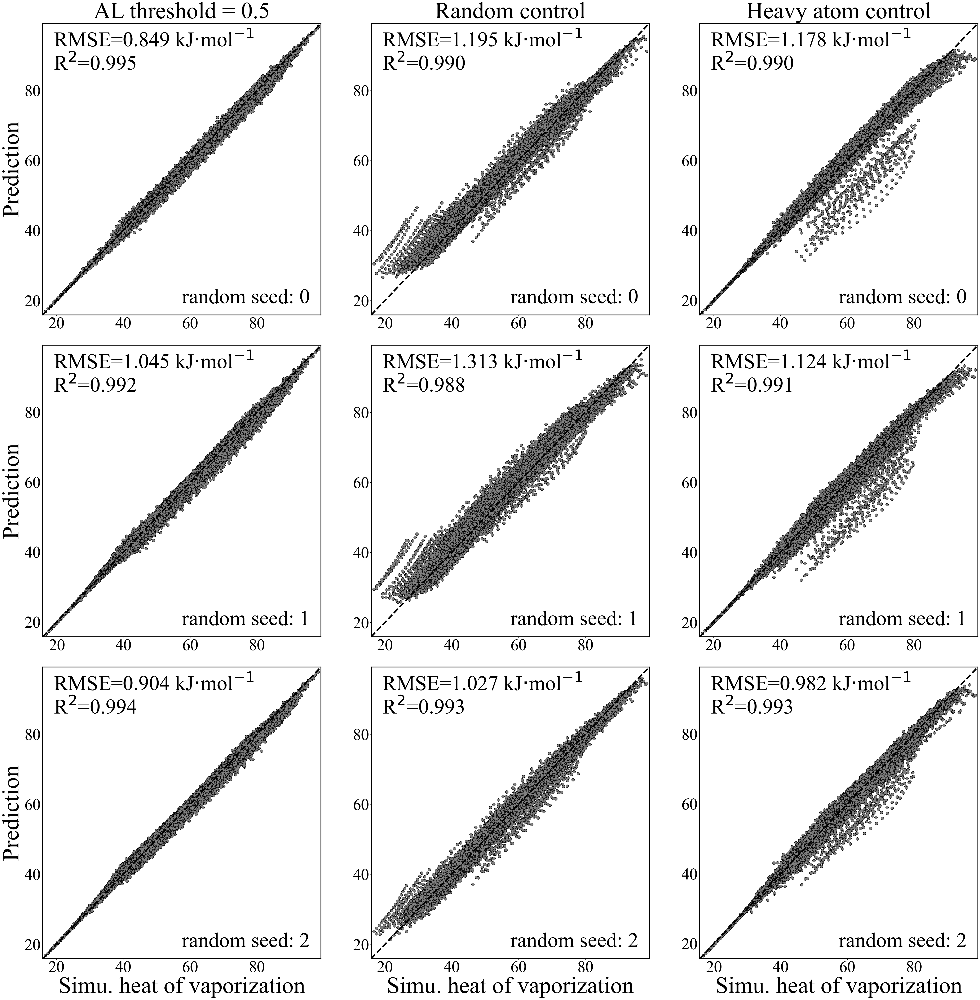

In [6]:
"""
fs = 16
params = {'legend.fontsize': '%s' % (4 * fs),
          'figure.figsize': (fs * 3, fs * 3),  # 8*6
          'axes.labelsize': '%s' % (5 * fs),
          'axes.titlesize': '%s' % (5 * fs),
          'xtick.labelsize': '%s' % (3.5 * fs),
          'ytick.labelsize': '%s' % (3.5 * fs),
          'font.family': 'serif',
          'font.serif': 'Times New Roman',
          'axes.linewidth': 3
          }
pylab.rcParams.update(params)
fig = plt.figure()
fig.tight_layout()

dxs = [0.06, 0.05, 0.05, 0.01]  # left to right
dx = (1 - sum(dxs)) / (len(dxs) - 1)
dys = [0.04, 0.03, 0.03, 0.03]  # down to top
dy = (1 - sum(dys)) / (len(dys) - 1)

for k, prop in enumerate(['density', 'cp', 'hvap']):
    prop_name = ['density', 'heat capacity', 'heat of vaporization'][k]
    unit = [r'kg$\cdot$m$^{-3}$', r'J$\cdot$mol$^{-1} \cdot$K$^{-1}$', r'kJ$\cdot$mol$^{-1}$'][k]
    fig = plt.figure()
    fig.tight_layout()
    for i, tag in enumerate(['0.5_', '0.5_random', '0.5_nheavy']):
        title = ['AL threshold = 0.5', 'Random control', 'Heavy atom control'][i]
        for j in range(3):
            nx = i + 1
            ny = j + 1
            ax = fig.add_axes(
                [sum(dxs[:nx]) + (nx - 1) * dx, sum(dys[:ny]) + (ny - 1) * dy, dx, dy])
            df = pd.read_csv(f'data_{tag}{2-j}/{prop}-pred.csv')
            df_true = pd.read_csv('data_sim_all/%s.csv' % prop)
            l, u, d, _, _, _ = plotxy(ax, df_true[prop], df[prop], square=True, size=100, color='gray')
            ax.plot([l, u], [l, u], c='k', linestyle='--', linewidth=fs/3)
            ax.text(l + 0.04 * d, u - 0.08 * d,
                    r'RMSE=%.3f %s' % (rmse(df_true[prop], df[prop]), unit),
                    fontsize=fs*4.5, color='k')
            ax.text(l + 0.04 * d, u - 0.16 * d,
                    r'R$^2$=%.3f' % (r2_score(df_true[prop], df[prop])),
                    fontsize=fs*4.5, color='k')
            ax.text(l + 0.5 * d, l + 0.04 * d, f'random seed: {2-j}', fontsize=fs * 4.5)
            if j == 0:
                ax.set_xlabel(f'Simu. {prop_name}')
            if j == 2:
                ax.set_title(title)
            if i == 0:
                ax.set_ylabel('Prediction')
            
    plt.savefig(f'figure{5+k}.png')
"""

<Figure size 4800x4800 with 0 Axes>

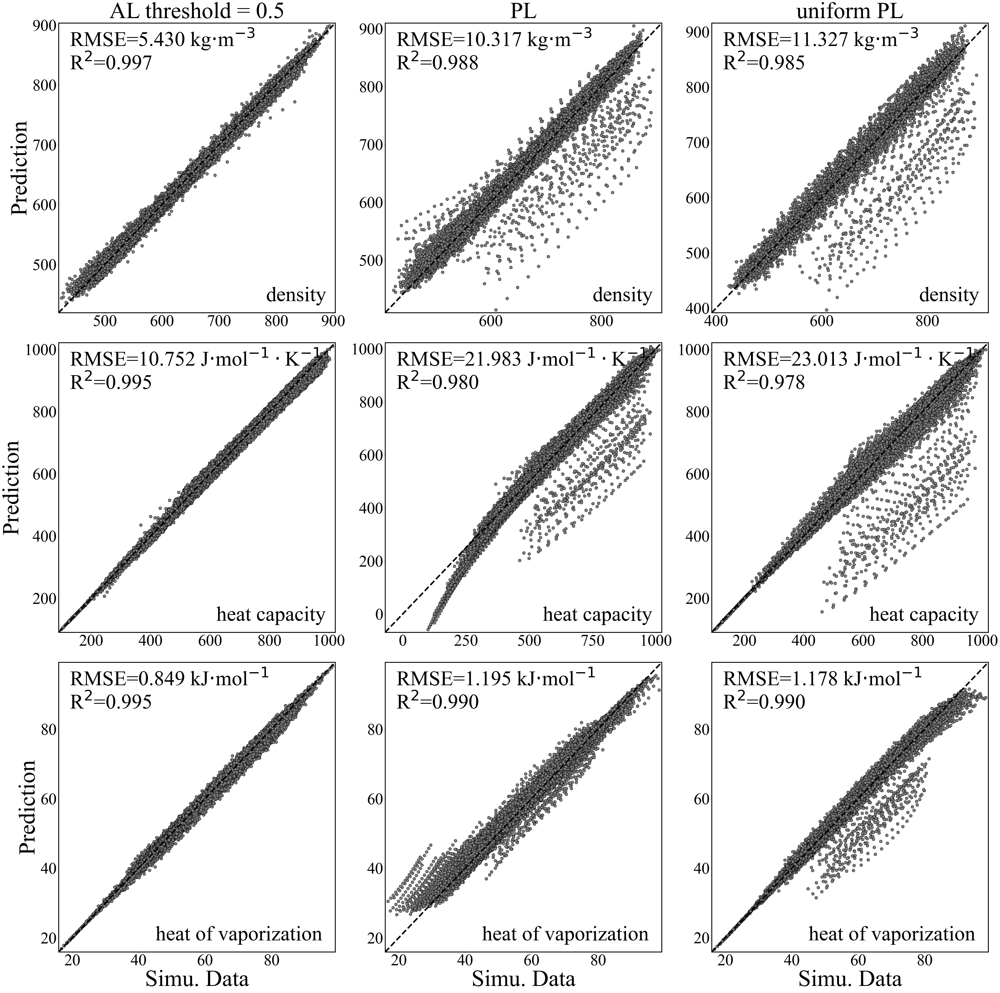

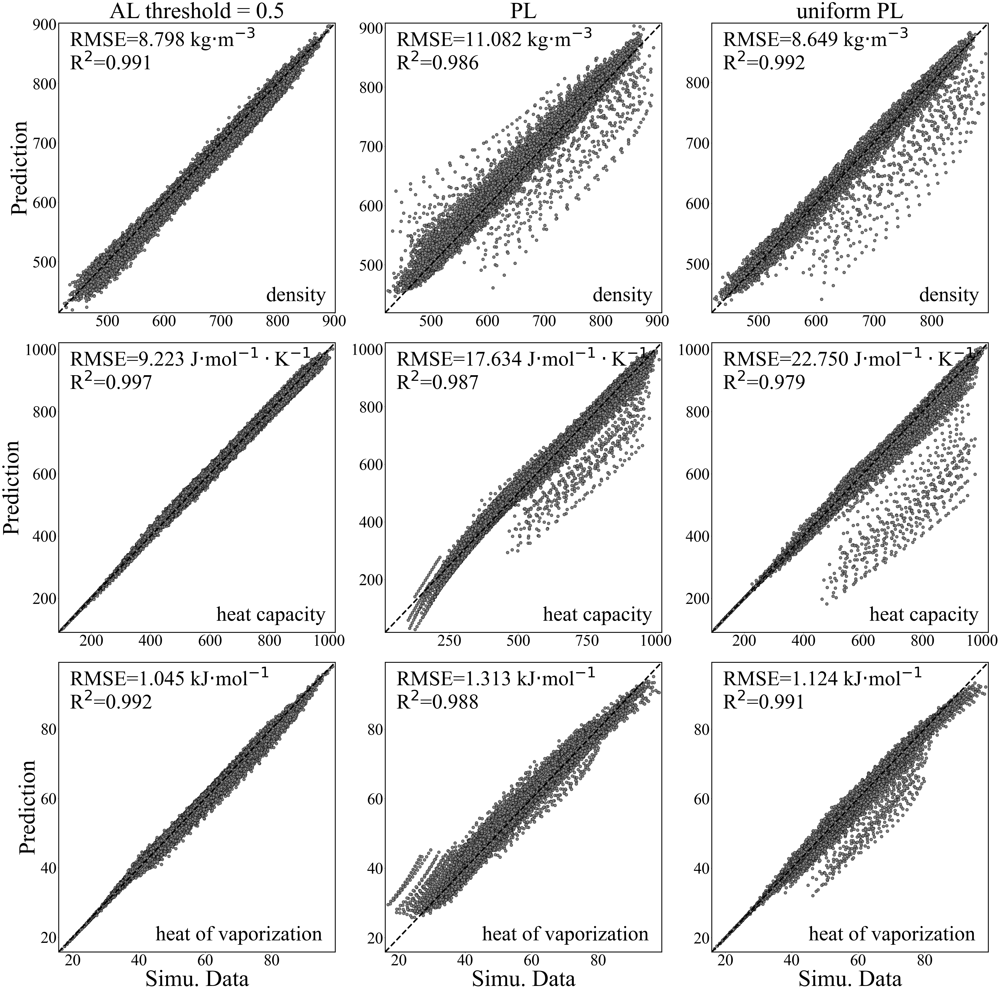

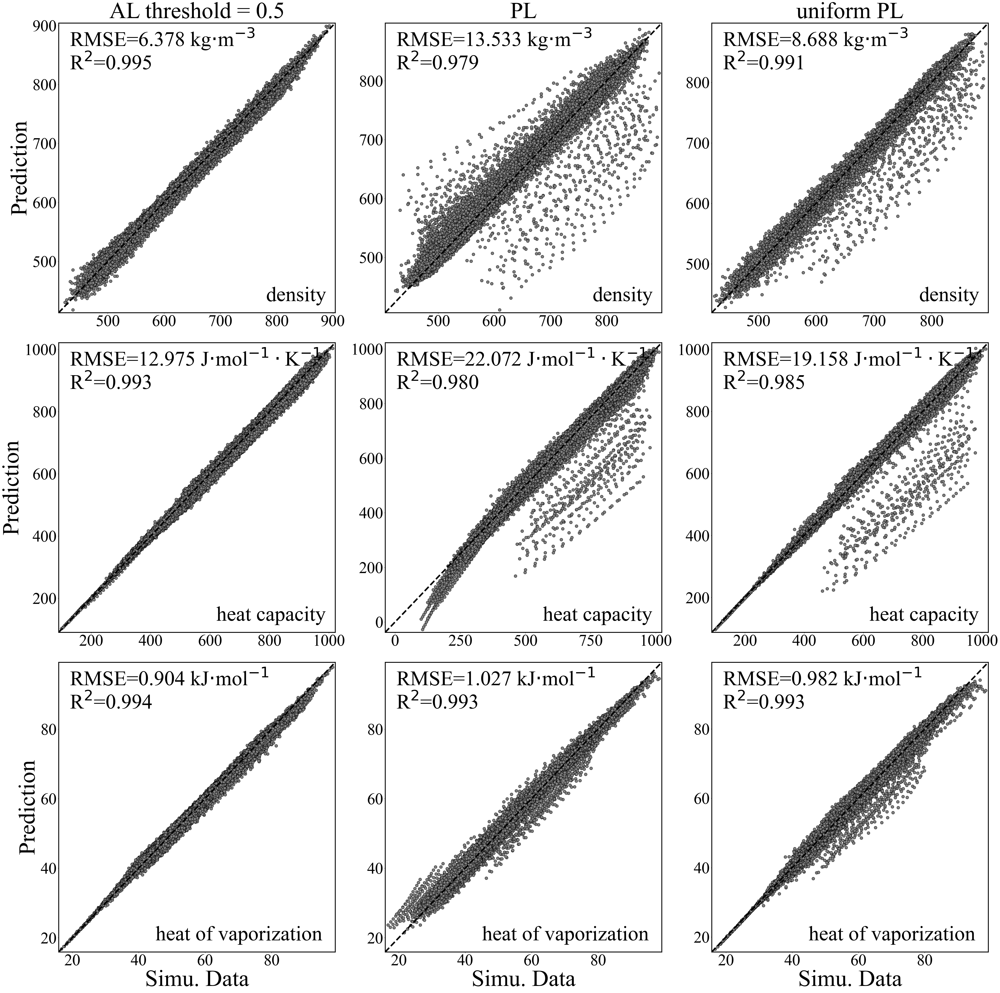

In [7]:
fs = 16
params = {'legend.fontsize': '%s' % (4 * fs),
          'figure.figsize': (fs * 3, fs * 3),  # 8*6
          'axes.labelsize': '%s' % (5 * fs),
          'axes.titlesize': '%s' % (5 * fs),
          'xtick.labelsize': '%s' % (3.5 * fs),
          'ytick.labelsize': '%s' % (3.5 * fs),
          'font.family': 'serif',
          'font.serif': 'Times New Roman',
          'axes.linewidth': 3
          }
pylab.rcParams.update(params)
fig = plt.figure()
fig.tight_layout()

dxs = [0.06, 0.05, 0.05, 0.01]  # left to right
dx = (1 - sum(dxs)) / (len(dxs) - 1)
dys = [0.04, 0.03, 0.03, 0.03]  # down to top
dy = (1 - sum(dys)) / (len(dys) - 1)

for k in range(3):
    fig = plt.figure()
    fig.tight_layout()
    for i, tag in enumerate(['0.5_', '0.5_random', '0.5_nheavy']):
        title = ['AL threshold = 0.5', 'PL', 'uniform PL'][i]
        for j, prop in enumerate(['hvap', 'cp', 'density']):
            prop_name = ['heat of vaporization', 'heat capacity', 'density'][j]
            unit = [r'kJ$\cdot$mol$^{-1}$', r'J$\cdot$mol$^{-1} \cdot$K$^{-1}$', r'kg$\cdot$m$^{-3}$'][j]
            
            nx = i + 1
            ny = j + 1
            ax = fig.add_axes(
                [sum(dxs[:nx]) + (nx - 1) * dx, sum(dys[:ny]) + (ny - 1) * dy, dx, dy])
            df = pd.read_csv(f'data_{tag}{k}/{prop}-pred.csv')
            df_true = pd.read_csv('data_sim_all/%s.csv' % prop)
            l, u, d, _, _, _ = plotxy(ax, df_true[prop], df[prop], square=True, size=100, color='gray')
            ax.plot([l, u], [l, u], c='k', linestyle='--', linewidth=fs/3)
            ax.text(l + 0.04 * d, u - 0.08 * d,
                    r'RMSE=%.3f %s' % (rmse(df_true[prop], df[prop]), unit),
                    fontsize=fs*4.5, color='k')
            ax.text(l + 0.04 * d, u - 0.16 * d,
                    r'R$^2$=%.3f' % (r2_score(df_true[prop], df[prop])),
                    fontsize=fs*4.5, color='k')
            if j == 2:
                ax.text(l + 0.75 * d, l + 0.04 * d, prop_name, fontsize=fs * 4.5)
            elif j == 1:
                ax.text(l + 0.57 * d, l + 0.04 * d, prop_name, fontsize=fs * 4.5)
            else:
                ax.text(l + 0.35 * d, l + 0.04 * d, prop_name, fontsize=fs * 4.5)
            if j == 0:
                ax.set_xlabel(f'Simu. Data')
            if j == 2:
                ax.set_title(title)
            if i == 0:
                ax.set_ylabel('Prediction')
    if k == 0:
        plt.savefig(f'figure5.png')
    else:
        plt.savefig(f'figure_s{k}.png')